In [61]:
!pip install catboost
!pip install emoji

In [62]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import altair as alt
import nltk
import numpy as np
import torchtext
import scipy
import torch
import torch.nn as nn

from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.dummy import DummyClassifier
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.model_selection import (
    GridSearchCV,
    RandomizedSearchCV,
    cross_val_score,
    cross_validate,
    train_test_split,
)
from sklearn.impute import SimpleImputer
from collections import Counter
from sklearn.feature_extraction import DictVectorizer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import accuracy_score, f1_score, make_scorer

from xgboost import XGBClassifier
from lightgbm.sklearn import LGBMClassifier
from catboost import CatBoostClassifier

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

from wordcloud import WordCloud, STOPWORDS
from scipy.stats import lognorm, loguniform, randint
from collections import Counter

from torch.utils.data import Dataset, DataLoader
from torch import optim
from torchtext.data import Field, LabelField
from torchtext.data import TabularDataset
from torchtext.data import Iterator, BucketIterator
from torchtext.vocab import Vectors


nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [63]:
import os
os.chdir("/content/drive/MyDrive/sent-analysis")
from feature_extractions_helper import *

In [64]:
df = pd.read_csv("data/processed/processed_data_7760.csv", index_col=0)

In [65]:
df.head()

,created_at,id,full_text,entities,is_quote_status,retweet_count,favorite_count,possibly_sensitive,keyword,location,hashtags_count,city,province,country,sentiment,past_tense_count,first_preson_pron_count,second_person_pron_count,third_person_pron_count,coord_conj_count,future_tense_count,commas_count,multi_punc_count,tags_count,cap_words_count,slang_acronym_count,sentence_count,avg_pos_words,avg_neg_words,avg_slang_sent,avg_len_sent,avg_len_tokens,processed_text
0,Mon Dec 21 17:31:03 +0000 2020,1.341074e+18,Today we add an important chapter to a Europea...,"['COVID19', 'EUvaccinationdays']",False,1557.0,5840.0,False,Covid19 vaccine,NaN,2.0,NaN,NaN,NaN,pos,0,1,0,1,0,2,2,0,"(9, 3, 0, 0)",2,0,2,0.086957,0.0,-0.025641,20.000000,4.850000,today we add an important chapter to a europea...
1,Tue Dec 22 20:20:16 +0000 2020,1.341479e+18,Sedgwick County has received its first allocat...,['COVID19'],False,9.0,50.0,False,Covid19 vaccine,"Sedgwick County, Kansas",1.0,Sedgwick County,KS,United States,neu,1,1,0,1,2,0,0,0,"(8, 6, 0, 1)",2,0,2,0.000000,0.0,0.000000,19.000000,5.421053,sedgwick county ha receive it first allocation...
2,Wed Dec 23 00:32:16 +0000 2020,1.341542e+18,Now is not the time to let up. Vaccines are he...,['COVID19'],False,0.0,0.0,False,Covid19 vaccine,Southern California,1.0,NaN,SC,United States,neu,1,0,0,1,2,1,2,0,"(13, 2, 4, 0)",1,0,2,0.020000,0.0,0.023256,21.500000,4.720930,now be not the time to let up vaccine be here ...
3,Tue Dec 22 16:34:35 +0000 2020,1.341422e+18,I received my #COVID19 vaccination today. It w...,['COVID19'],False,139.0,1008.0,False,Covid19 vaccine,NaN,1.0,NaN,NaN,NaN,pos,2,3,0,3,1,0,1,0,"(10, 1, 2, 0)",3,0,3,0.083333,0.0,0.000000,14.333333,4.627907,i receive my covid vaccination today it wa gre...
4,Sat Dec 19 18:58:07 +0000 2020,1.340371e+18,. Gen. Gus Perna on the distribution of the Mo...,['COVID19'],False,325.0,1784.0,False,Covid19 vaccine,"The Pentagon, Washington, D.C.",1.0,NaN,DC,United States,neu,0,0,0,0,0,0,0,0,"(2, 5, 0, 0)",1,0,4,0.000000,0.0,0.000000,3.750000,4.642857,gen gu perna on the distribution of the modern...


## Data Splitting

In [66]:
train_df, validation_df = train_test_split(df, test_size = 0.3, random_state=123)

In [67]:
print("Train set shape is ,", train_df.shape)
print("Validation set shape is ,", validation_df.shape)

Train set shape is , (5432, 33)
Validation set shape is , (2328, 33)


## EDA

In [68]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5432 entries, 4898 to 3582
Data columns (total 33 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   created_at                5432 non-null   object 
 1   id                        5432 non-null   float64
 2   full_text                 5432 non-null   object 
 3   entities                  5432 non-null   object 
 4   is_quote_status           5432 non-null   bool   
 5   retweet_count             5432 non-null   float64
 6   favorite_count            5432 non-null   float64
 7   possibly_sensitive        3357 non-null   object 
 8   keyword                   5432 non-null   object 
 9   location                  4109 non-null   object 
 10  hashtags_count            5432 non-null   float64
 11  city                      2395 non-null   object 
 12  province                  2006 non-null   object 
 13  country                   3388 non-null   object 
 14  senti

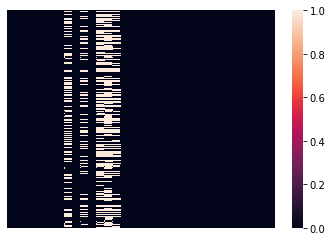

In [69]:
sns.heatmap(train_df.isna(), xticklabels=False, yticklabels=False)

In [70]:
alt.data_transformers.disable_max_rows()
alt.Chart(train_df).mark_bar().encode(
    alt.X("sentiment", title="Tweet sentiment"),
    alt.Y("count()", title="Number of tweets")
).properties(title="Number of tweets across all sentiments", width=200)

alt.Chart(...)

In [71]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("country", title="Counrty", sort='-y'),
    alt.Y("count(sentiment)", title="Number of tweets"),
).properties(title="Number of tweets across all countries")

alt.Chart(...)

In [72]:
country_majority = train_df.query("country in ['United States', 'United Kingdom', 'Canada', 'India']")
alt.Chart(country_majority).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="country")

alt.FacetChart(...)

In [73]:
subset_usa = train_df[train_df["country"] == "United States"]
alt.Chart(subset_usa).mark_bar().encode(
    alt.X("province", title="USA Province code", sort="-y"),
    alt.Y("count(sentiment)", title="Number of tweets")
).properties(title="Number of tweets across all provinces in USA")

alt.Chart(...)

In [74]:
alt.Chart(subset_usa.query("province in ['NY', 'CA', 'DC']")).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="province")

alt.FacetChart(...)

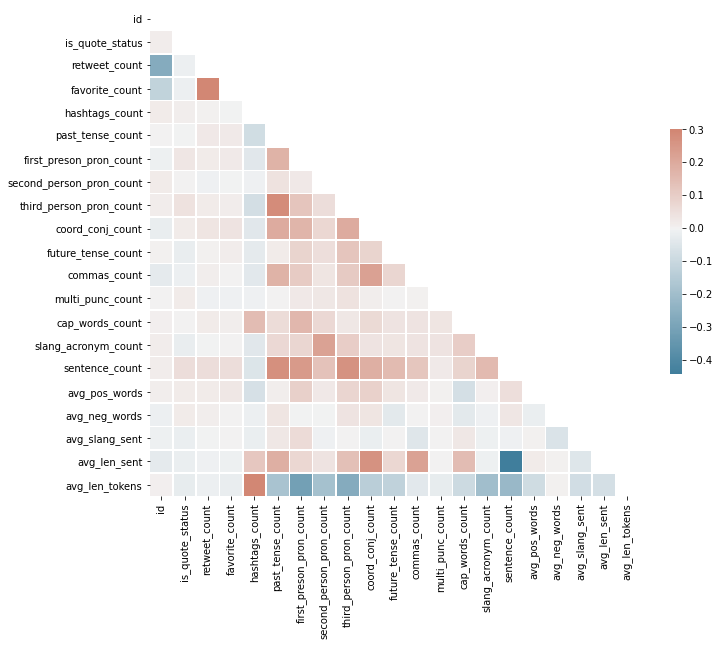

In [75]:
# Compute the correlation matrix
corr = train_df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [76]:
numeric_cols = train_df.select_dtypes('number').drop(columns=[
    'id','retweet_count', 'favorite_count']).columns.tolist()

(alt.Chart(train_df).mark_bar().encode(
    alt.X(alt.repeat(), type='quantitative', bin=alt.Bin(maxbins=40)),
    y='count()',
    color="sentiment")
 .properties(height=80, width=200)
 .repeat(repeat=numeric_cols, columns=2))

alt.RepeatChart(...)

In [77]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("keyword")
).properties(height=80).facet(row="keyword")

alt.FacetChart(...)

In [78]:
wc_stopwords = STOPWORDS | {"amp", "vaccine","vaccines", "covid 19", "covid", "covid19", "will", 'covid19 vaccine', 'pfizer', 'astrazeneca', 'moderna'}
wordcloud = WordCloud(background_color="white", max_words=2000, stopwords=wc_stopwords)

def generate_wordcloud(wordCloud, subset):
    sub_df = train_df[train_df["sentiment"] == subset]
    text = " ".join(sub_df.full_text).lower()
    wordcloud.generate(text)
    fig = plt.figure()
    fig.set_figwidth(14) # set width
    fig.set_figheight(18) # set height
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

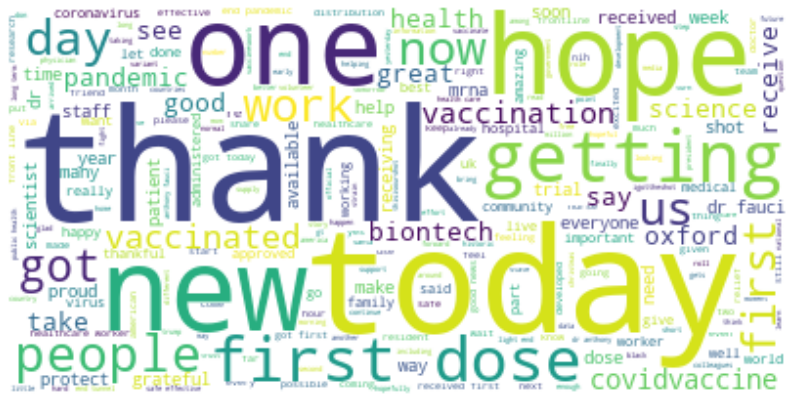

In [79]:
generate_wordcloud(wordcloud, "pos")

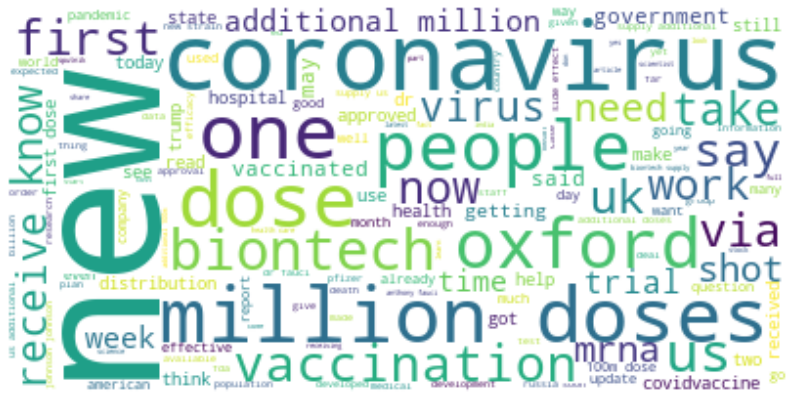

In [80]:
generate_wordcloud(wordcloud, "neu")

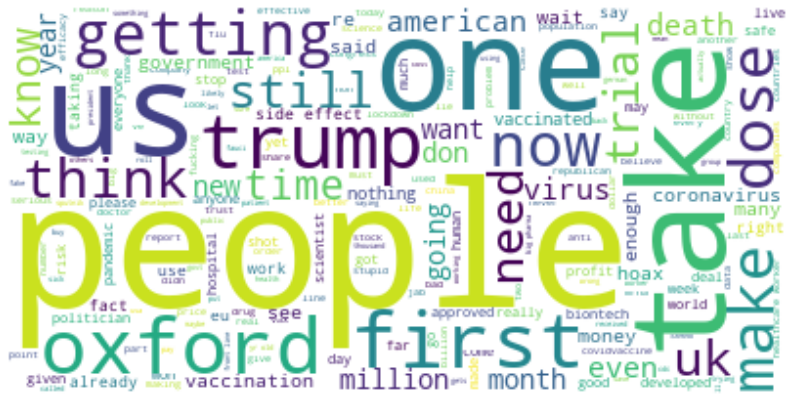

In [81]:
generate_wordcloud(wordcloud, "neg")

In [82]:
train_df.columns

Index(['created_at', 'id', 'full_text', 'entities', 'is_quote_status',
       'retweet_count', 'favorite_count', 'possibly_sensitive', 'keyword',
       'location', 'hashtags_count', 'city', 'province', 'country',
       'sentiment', 'past_tense_count', 'first_preson_pron_count',
       'second_person_pron_count', 'third_person_pron_count',
       'coord_conj_count', 'future_tense_count', 'commas_count',
       'multi_punc_count', 'tags_count', 'cap_words_count',
       'slang_acronym_count', 'sentence_count', 'avg_pos_words',
       'avg_neg_words', 'avg_slang_sent', 'avg_len_sent', 'avg_len_tokens',
       'processed_text'],
      dtype='object')

## Preprocessing

In [83]:
drop_features = ["created_at", "id", "entities", "is_quote_status", "location", "tags_count"] # I'll add tags_counts later
target = "sentiment"
categorical_features = ["keyword", "city", "province", "country"]
text_feature = "processed_text"

In [84]:
numeric_list = train_df.select_dtypes(include=np.number).columns.tolist()
numeric_set = set(numeric_list) - {"id"}
numeric_set.add("possibly_sensitive") # numeric feature
numeric_features = list(numeric_set)

In [85]:
# spliting X_train and y_train

X_train, y_train = train_df.drop(columns=drop_features).drop(columns=[target]), train_df[target]
# X_test, y_test = test_df.drop(columns=drop_features).drop(columns=[target]), test_df[target]

In [86]:
# The scoring function is adapted from the lecture note of DSCI-573.
results = {}

def mean_std_cross_val_scores(model, X_train, y_train, **kwargs):
    """
    Returns mean and std of cross validation.
    """
    scores = cross_validate(model, X_train, y_train, **kwargs)

    mean_scores = pd.DataFrame(scores).mean()
    std_scores = pd.DataFrame(scores).std()
    out_col = []

    for i in range(len(mean_scores)):
        out_col.append((f"%0.3f (+/- %0.3f)" % (mean_scores[i], std_scores[i])))

    return pd.Series(data=out_col, index=mean_scores.index)

In [87]:
numeric_transformer = make_pipeline(SimpleImputer(strategy="median"),
                                    StandardScaler())
categorical_transformer = make_pipeline(SimpleImputer(strategy="constant", fill_value="missing"),
                                        OneHotEncoder(handle_unknown="ignore"))

preprocessor_non_bow = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features))
preprocessor_non_bow

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
                  transformer_weights=None,
                  transformers=[('pipeline-1',
                                 Pipeline(memory=None,
                                          steps=[('simpleimputer',
                                                  SimpleImputer(add_indicator=False,
                                                                copy=True,
                                                                fill_value=None,
                                                                missing_values=nan,
                                                                strategy='median',
                                                                verbose=0)),
                                                 ('standardscaler',
                                                  StandardScaler(copy=True,
                                                                 with_mean=True,
      

In [88]:
dummy = make_pipeline(preprocessor_non_bow, DummyClassifier(strategy="most_frequent"))
scorer = make_scorer(f1_score, average="micro")

results["dummy"] = mean_std_cross_val_scores(
    dummy, X_train, y_train, scoring=scorer, return_train_score=True
)
pipe_lr_non_bow = make_pipeline(
    preprocessor_non_bow,
    LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+non_text"] = mean_std_cross_val_scores(
    pipe_lr_non_bow, X_train, y_train, scoring=scorer, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003)


#### Text representation: Bag of words

In [89]:
c = Counter(" ".join(train_df.processed_text).split())
c.most_common(10)

[('the', 7427),
 ('vaccine', 5265),
 ('be', 4365),
 ('to', 3897),
 ('covid', 3370),
 ('of', 3076),
 ('a', 2863),
 ('and', 2521),
 ('in', 2115),
 ('for', 1721)]

In [90]:
bow_preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features),
    (CountVectorizer(ngram_range=(1, 2), stop_words="english"), text_feature) # unigram and bigram
)
bow_preprocessor

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
                  transformer_weights=None,
                  transformers=[('pipeline-1',
                                 Pipeline(memory=None,
                                          steps=[('simpleimputer',
                                                  SimpleImputer(add_indicator=False,
                                                                copy=True,
                                                                fill_value=None,
                                                                missing_values=nan,
                                                                strategy='median',
                                                                verbose=0)),
                                                 ('standardscaler',
                                                  StandardScaler(copy=True,
                                                                 with_mean=True,
      

In [91]:
X_train_enc = bow_preprocessor.fit_transform(X_train, y_train)

# vocabulary list 
vocab = bow_preprocessor.named_transformers_['countvectorizer'].vocabulary_

# getting feature names
num_features = numeric_features
ohe_features = bow_preprocessor.named_transformers_['pipeline-2']['onehotencoder'].get_feature_names().tolist()
vocab = bow_preprocessor.named_transformers_['countvectorizer'].get_feature_names()

enc_columns = num_features + ohe_features + vocab

# the number of features we have
len(enc_columns)

58030

In [92]:
pipe_bow_lr = make_pipeline(
    bow_preprocessor, LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+BOW"] = mean_std_cross_val_scores(
    pipe_bow_lr, X_train, y_train, scoring=scorer, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text,LR+BOW
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026),6.605 (+/- 0.328)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000),0.094 (+/- 0.024)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007),0.758 (+/- 0.006)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003),0.997 (+/- 0.001)


#### **Bag of words features improve the performance of logistic regression.**

#### Text representation: TF-IDF

In [93]:
# TF-IDF text representation
tfidf_preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features),
    (TfidfVectorizer(ngram_range=(1, 2), stop_words="english"), text_feature) # unigram and bigram
)
tfidf_preprocessor

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
                  transformer_weights=None,
                  transformers=[('pipeline-1',
                                 Pipeline(memory=None,
                                          steps=[('simpleimputer',
                                                  SimpleImputer(add_indicator=False,
                                                                copy=True,
                                                                fill_value=None,
                                                                missing_values=nan,
                                                                strategy='median',
                                                                verbose=0)),
                                                 ('standardscaler',
                                                  StandardScaler(copy=True,
                                                                 with_mean=True,
      

In [94]:
# find features after preprocessing
X_train_enc = tfidf_preprocessor.fit_transform(X_train, y_train)
vocab = tfidf_preprocessor.named_transformers_['tfidfvectorizer'].vocabulary_

# getting feature names
num_features = numeric_features
tfidf_ohe_features = tfidf_preprocessor.named_transformers_['pipeline-2']['onehotencoder'].get_feature_names().tolist()
tfidf_vocab = tfidf_preprocessor.named_transformers_['tfidfvectorizer'].get_feature_names()

tf_idf_enc_columns = num_features + tfidf_ohe_features + tfidf_vocab
len(tf_idf_enc_columns)

58030

In [95]:
pipe_tfidf_lr = make_pipeline(
    tfidf_preprocessor, LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+TFIDF"] = mean_std_cross_val_scores(
    pipe_tfidf_lr, X_train, y_train, scoring=scorer, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text,LR+BOW,LR+TFIDF
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026),6.605 (+/- 0.328),8.169 (+/- 0.390)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000),0.094 (+/- 0.024),0.099 (+/- 0.014)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007),0.758 (+/- 0.006),0.755 (+/- 0.006)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003),0.997 (+/- 0.001),0.892 (+/- 0.002)


#### **Bag of words perform better than TFIDF on this task.**

#### Hyperparamter on BOW

In [96]:
param_grid = {
    "columntransformer__countvectorizer__max_features": np.arange(50, len(enc_columns)),
    "columntransformer__countvectorizer__max_df": np.arange(10000, 70000, 5000),
    "columntransformer__countvectorizer__min_df": np.arange(1, 10),
}

random_search = RandomizedSearchCV(
    pipe_bow_lr,
    param_grid,
    n_iter=30,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    scoring=scorer,
    return_train_score=True,
)

random_search.fit(X_train, y_train);

Fitting 5 folds for each of 30 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:   55.8s
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  2.9min finished


In [97]:
random_search.best_score_

0.7485272964772016

**BOW performs best when using default hyperparameters.**

## Linear Models

### Logistic Regression + Hyperparameter Tuning

In [98]:
param_grid = {"logisticregression__C": loguniform(1e-4, 1e4)}

random_search = RandomizedSearchCV(
    pipe_bow_lr,
    param_grid,
    n_iter=30,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    scoring=scorer,
    return_train_score=True,
)

random_search.fit(X_train, y_train);

Fitting 5 folds for each of 30 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  8.6min finished


In [99]:
random_search.best_score_

0.7614154218361653

**There's no improvement when tuning C, so keep the default value.**

## Non-linear Models

#### Classification + Ensembles

In [100]:
pipe_rf = make_pipeline(
    bow_preprocessor, RandomForestClassifier(random_state=123)
)
pipe_xgb = make_pipeline(
    bow_preprocessor, XGBClassifier(random_state=123)
)
pipe_lgbm = make_pipeline(
    bow_preprocessor, LGBMClassifier(random_state=123)
)
pipe_cat = make_pipeline(bow_preprocessor, CatBoostClassifier(random_state=123, verbose=0))
pipe_svc = make_pipeline(bow_preprocessor, SVC(random_state=123))
pipe_dt = make_pipeline(bow_preprocessor, DecisionTreeClassifier(random_state=123))


classifiers = {
    "Random Forest": pipe_rf,
    "XGBoost": pipe_xgb,
    "LGBM": pipe_lgbm,
    "SVM_RBF": pipe_svc,
    "Decision Tree": pipe_dt,
    "CatBoost": pipe_cat
}

In [101]:
for name, model in classifiers.items():
    results[name] = mean_std_cross_val_scores(model, X_train, y_train, scoring=scorer, return_train_score=True)


In [102]:
pd.DataFrame(results)

,dummy,LR+non_text,LR+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,SVM_RBF,Decision Tree,CatBoost
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026),6.605 (+/- 0.328),8.169 (+/- 0.390),5.559 (+/- 0.108),13.736 (+/- 0.030),1.993 (+/- 0.020),6.288 (+/- 0.107),1.785 (+/- 0.049),316.560 (+/- 5.205)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000),0.094 (+/- 0.024),0.099 (+/- 0.014),0.131 (+/- 0.003),0.083 (+/- 0.004),0.078 (+/- 0.003),1.099 (+/- 0.015),0.049 (+/- 0.001),0.149 (+/- 0.005)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007),0.758 (+/- 0.006),0.755 (+/- 0.006),0.697 (+/- 0.004),0.741 (+/- 0.004),0.747 (+/- 0.004),0.737 (+/- 0.008),0.679 (+/- 0.012),0.756 (+/- 0.004)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003),0.997 (+/- 0.001),0.892 (+/- 0.002),1.000 (+/- 0.000),0.785 (+/- 0.003),0.922 (+/- 0.002),0.900 (+/- 0.001),1.000 (+/- 0.000),0.820 (+/- 0.002)


**XGBoost and LGBM are two strong candidates.**

LGBM Hyperparameters Tuning

In [103]:
param_grid_lgbm = {
    "lgbmclassifier__n_estimators": randint(10, 200),
    "lgbmclassifier__learning_rate": [0.001, 0.01, 0.1],
    "lgbmclassifier__max_depth": randint(low=2, high=30),
    "lgbmclassifier__subsample": [0.5, 0.75, 1],
}

In [104]:
random_search_lgbm = RandomizedSearchCV(
    pipe_lgbm,
    param_grid_lgbm,
    n_iter=50,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    scoring=scorer,
    return_train_score=True,
)

random_search_lgbm.fit(X_train, y_train);

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:  4.8min
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed:  6.3min finished


In [105]:
random_search_lgbm.best_score_

0.7479770127795257

In [106]:
random_search_lgbm.best_params_

{'lgbmclassifier__learning_rate': 0.1,
 'lgbmclassifier__max_depth': 21,
 'lgbmclassifier__n_estimators': 131,
 'lgbmclassifier__subsample': 1}

In [107]:
best_lgbm_model = random_search_lgbm.best_estimator_
results["LGBM (tuned)"] = mean_std_cross_val_scores(
    best_lgbm_model, X_train, y_train, scoring=scorer, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text,LR+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,SVM_RBF,Decision Tree,CatBoost,LGBM (tuned)
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026),6.605 (+/- 0.328),8.169 (+/- 0.390),5.559 (+/- 0.108),13.736 (+/- 0.030),1.993 (+/- 0.020),6.288 (+/- 0.107),1.785 (+/- 0.049),316.560 (+/- 5.205),2.381 (+/- 0.070)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000),0.094 (+/- 0.024),0.099 (+/- 0.014),0.131 (+/- 0.003),0.083 (+/- 0.004),0.078 (+/- 0.003),1.099 (+/- 0.015),0.049 (+/- 0.001),0.149 (+/- 0.005),0.081 (+/- 0.002)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007),0.758 (+/- 0.006),0.755 (+/- 0.006),0.697 (+/- 0.004),0.741 (+/- 0.004),0.747 (+/- 0.004),0.737 (+/- 0.008),0.679 (+/- 0.012),0.756 (+/- 0.004),0.748 (+/- 0.007)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003),0.997 (+/- 0.001),0.892 (+/- 0.002),1.000 (+/- 0.000),0.785 (+/- 0.003),0.922 (+/- 0.002),0.900 (+/- 0.001),1.000 (+/- 0.000),0.820 (+/- 0.002),0.946 (+/- 0.003)


XGBoost Hyperparameter Tuning

In [108]:
param_grid_xgb = {
    "xgbclassifier__n_estimators": randint(10, 200),
    "xgbclassifier__learning_rate": [0.001, 0.01, 0.1],
    "xgbclassifier__max_depth": randint(low=2, high=30),
    "xgbclassifier__subsample": [0.5, 0.75, 1],
}

In [109]:
random_search_xgb = RandomizedSearchCV(
    pipe_xgb,
    param_grid_xgb,
    n_iter=50,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    scoring=scorer,
    return_train_score=True,
)

random_search_xgb.fit(X_train, y_train);

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed: 51.5min
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed: 230.5min
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed: 323.0min finished


In [110]:
random_search_xgb.best_score_

0.7501854327300205

In [111]:
random_search_xgb.best_params_

{'xgbclassifier__learning_rate': 0.1,
 'xgbclassifier__max_depth': 6,
 'xgbclassifier__n_estimators': 106,
 'xgbclassifier__subsample': 0.5}

**Hyperparameter Tunning does not really help with XGBoost and LGBM**

### Averaging & Stacking

In [112]:
best_classifiers = {
    "XGBoost": pipe_xgb,
    "LGBM": pipe_lgbm,
    "SVM_RBF": pipe_svc
}

In [113]:
averaging_model = VotingClassifier(
    list(best_classifiers.items())
)
results["Voting"] = mean_std_cross_val_scores(averaging_model, X_train, y_train, scoring=scorer, return_train_score=True)

In [114]:
stacking_model = StackingClassifier(list(best_classifiers.items()))
results["Stacking"] = mean_std_cross_val_scores(
    stacking_model, X_train, y_train, scoring=scorer, return_train_score=True
)
pd.DataFrame(results)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


,dummy,LR+non_text,LR+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,SVM_RBF,Decision Tree,CatBoost,LGBM (tuned),Voting,Stacking
fit_time,0.037 (+/- 0.002),0.649 (+/- 0.026),6.605 (+/- 0.328),8.169 (+/- 0.390),5.559 (+/- 0.108),13.736 (+/- 0.030),1.993 (+/- 0.020),6.288 (+/- 0.107),1.785 (+/- 0.049),316.560 (+/- 5.205),2.381 (+/- 0.070),21.845 (+/- 0.418),109.970 (+/- 0.987)
score_time,0.012 (+/- 0.001),0.014 (+/- 0.000),0.094 (+/- 0.024),0.099 (+/- 0.014),0.131 (+/- 0.003),0.083 (+/- 0.004),0.078 (+/- 0.003),1.099 (+/- 0.015),0.049 (+/- 0.001),0.149 (+/- 0.005),0.081 (+/- 0.002),1.255 (+/- 0.029),1.248 (+/- 0.015)
test_score,0.684 (+/- 0.000),0.705 (+/- 0.007),0.758 (+/- 0.006),0.755 (+/- 0.006),0.697 (+/- 0.004),0.741 (+/- 0.004),0.747 (+/- 0.004),0.737 (+/- 0.008),0.679 (+/- 0.012),0.756 (+/- 0.004),0.748 (+/- 0.007),0.746 (+/- 0.006),0.754 (+/- 0.006)
train_score,0.684 (+/- 0.000),0.742 (+/- 0.003),0.997 (+/- 0.001),0.892 (+/- 0.002),1.000 (+/- 0.000),0.785 (+/- 0.003),0.922 (+/- 0.002),0.900 (+/- 0.001),1.000 (+/- 0.000),0.820 (+/- 0.002),0.946 (+/- 0.003),0.890 (+/- 0.001),0.901 (+/- 0.003)


**Stacking is better than averaging**

## Interpretation

In [115]:
pipe_bow_lr.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('columntransformer',
                 ColumnTransformer(n_jobs=None, remainder='drop',
                                   sparse_threshold=0.3,
                                   transformer_weights=None,
                                   transformers=[('pipeline-1',
                                                  Pipeline(memory=None,
                                                           steps=[('simpleimputer',
                                                                   SimpleImputer(add_indicator=False,
                                                                                 copy=True,
                                                                                 fill_value=None,
                                                                                 missing_values=nan,
                                                                                 strategy='median',
                                           

In [116]:
coef_matrix = pd.DataFrame(data={"feature": enc_columns, 
                   "coeff" : pipe_bow_lr.named_steps["logisticregression"].coef_[0]
                   })

In [117]:
coef_matrix["abs_coeff"] = abs(coef_matrix.coeff)
coef_matrix.sort_values(by="abs_coeff", ascending=False)[20:40]

,feature,coeff,abs_coeff
18251,face_with_rolling_eyes,0.614254,0.614254
24238,idiot,0.613624,0.613624
22,x0_moderna,-0.611597,0.611597
18461,fake,0.606601,0.606601
45207,sign,-0.599632,0.599632
39233,propaganda,0.576601,0.576601
57365,worse covid,0.566216,0.566216
23570,hope,-0.564929,0.564929
27819,le effective,0.562375,0.562375
26991,justify astrazeneca,0.561493,0.561493


#Deployment stuff:

In [ ]:
model_name_here.save("final_model")

import joblib
# joblib.dump(scaler,’iris_scaler.pkl’)

# from flask import Flask, render_template, session, redirect, url_for, session
# from flask_wtf import FlaskForm
# from wtforms import TextField,SubmitField
# from wtforms.validators import NumberRange
# import numpy as np 
# from tensorflow.keras.models import load_model
# import joblib

NameError: ignored

In [ ]:
while True:pass